# Generative Adversarial Network
## Credit to: https://heartbeat.fritz.ai/introduction-to-generative-adversarial-networks-gans-35ef44f21193

In [1]:
import keras
import matplotlib.pyplot as plt
from keras.layers import Input
from keras.models import Model, Sequential
from keras.layers.core import Dense, Dropout
from keras.layers.advanced_activations import LeakyReLU
from keras.datasets import mnist
from keras.optimizers import Adam
from keras import initializers
from tqdm import tqdm

Using TensorFlow backend.


In [2]:
import numpy as np
np.random.seed(1000)
#Next we set the dimension of a random noise vector.
random_dim = 100

In [3]:
def load_minst_data():
  (x_train, y_train), (x_test, y_test) = mnist.load_data()
  x_train = x_train.reshape(-1, 784) / 255
  x_test = x_test.reshape(-1, 784) / 255
  return (x_train, y_train, x_test, y_test)

x_train, y_train, x_test, y_test = load_minst_data()

In [4]:
print(x_train.shape,x_test.shape)

(60000, 784) (10000, 784)


In [5]:
optimizer = Adam(lr=0.0002, beta_1=0.5)

In [6]:
generator = Sequential()
generator.add(Dense(256, input_dim=random_dim, kernel_initializer=initializers.RandomNormal(stddev=0.02)))
generator.add(LeakyReLU(0.2))
generator.add(Dense(512))
generator.add(LeakyReLU(0.2))
generator.add(Dense(1024))
generator.add(LeakyReLU(0.2))
generator.add(Dense(784, activation='tanh'))
generator.compile(loss='binary_crossentropy', optimizer=optimizer)

In [7]:
discriminator = Sequential()
discriminator.add(Dense(1024, input_dim=784, kernel_initializer=initializers.RandomNormal(stddev=0.02)))
discriminator.add(LeakyReLU(0.2))
discriminator.add(Dropout(0.3))
discriminator.add(Dense(512))
discriminator.add(LeakyReLU(0.2))
discriminator.add(Dropout(0.3))
discriminator.add(Dense(256))
discriminator.add(LeakyReLU(0.2))
discriminator.add(Dropout(0.3))
discriminator.add(Dense(1, activation='sigmoid'))
discriminator.compile(loss='binary_crossentropy', optimizer=optimizer)

In [8]:
discriminator.trainable = False
ganInput = Input(shape=(random_dim,))

In [9]:
x = generator(ganInput)
ganOutput = discriminator(x)
gan = Model(inputs=ganInput, outputs=ganOutput)
gan.compile(loss='binary_crossentropy', optimizer=optimizer)

In [10]:
20%10

0

In [11]:
def plot_generated_images(epoch, generator, examples=100, dim=(10, 10), figsize=(10, 10)):
  noise = np.random.normal(0, 1, size=[examples, random_dim])
  generated_images = generator.predict(noise)
  generated_images = generated_images.reshape(examples, 28, 28)
  plt.figure(figsize=figsize)
  for i in range(generated_images.shape[0]):
    plt.subplot(dim[0], dim[1], i+1)
    plt.imshow(generated_images[i], interpolation='nearest', cmap='gray_r')
    plt.axis('off')
  plt.tight_layout()
  
  if epoch in [1,20,40,60,80,100]:
    plt.savefig('image_generated_%d.png' % epoch)

In [12]:
def train(epochs=1, batch_size=128):
  x_train, y_train, x_test, y_test = load_minst_data()
  batch_count = x_train.shape[0] / batch_size
  for e in range(1, epochs+1):
    print('-'*10, 'Epoch %d' % e, '-'*10)
    for _ in tqdm(range(int(batch_count))):
        
      noise = np.random.normal(0, 1, size=[batch_size, random_dim])
      image_batch = x_train[np.random.randint(0, x_train.shape[0], size=batch_size)]
      generated_images = generator.predict(noise)
      X = np.concatenate([image_batch, generated_images])
      y_dis = np.zeros(2*batch_size)
      y_dis[:batch_size] = 0.9
      discriminator.trainable = True
      discriminator.train_on_batch(X, y_dis)
        
      noise = np.random.normal(0, 1, size=[batch_size, random_dim])
      y_gen = np.ones(batch_size)
      discriminator.trainable = False
      gan.train_on_batch(noise, y_gen)
                            
    plot_generated_images(e, generator)

---------- Epoch 1 ----------



 90%|█████████████████████████████████████████████████▏     | 419/468 [00:10<00:01, 40.89it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.07it/s]

---------- Epoch 2 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 42.11it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 42.08it/s]

---------- Epoch 3 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.95it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.92it/s]

---------- Epoch 4 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.63it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.61it/s]


---------- Epoch 5 ----------



 89%|█████████████████████████████████████████████████      | 417/468 [00:10<00:01, 41.07it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.14it/s]

---------- Epoch 6 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.82it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.79it/s]

---------- Epoch 7 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.72it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.71it/s]

---------- Epoch 8 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.66it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.66it/s]

---------- Epoch 9 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.53it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.56it/s]

---------- Epoch 10 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.53it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.57it/s]

---------- Epoch 11 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.64it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.48it/s]

---------- Epoch 12 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.57it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.56it/s]

---------- Epoch 13 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.49it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.51it/s]


---------- Epoch 14 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.57it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.59it/s]

---------- Epoch 15 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.46it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.45it/s]

---------- Epoch 16 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.43it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.43it/s]

---------- Epoch 17 ----------



 88%|████████████████████████████████████████████████▌      | 413/468 [00:10<00:01, 40.98it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.04it/s]


---------- Epoch 18 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.41it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.45it/s]

---------- Epoch 19 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.24it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.27it/s]

---------- Epoch 20 ----------



 90%|█████████████████████████████████████████████████▌     | 422/468 [00:10<00:01, 41.43it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.48it/s]

---------- Epoch 21 ----------



 90%|█████████████████████████████████████████████████▍     | 421/468 [00:10<00:01, 41.35it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.35it/s]c:\users\leo\appdata\local\programs\python\python36\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


---------- Epoch 22 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.47it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.46it/s]

---------- Epoch 23 ----------



 90%|█████████████████████████████████████████████████▌     | 422/468 [00:10<00:01, 41.23it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.21it/s]

---------- Epoch 24 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.29it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.08it/s]


---------- Epoch 25 ----------



 83%|█████████████████████████████████████████████▋         | 389/468 [00:10<00:02, 36.67it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:12<00:00, 37.36it/s]

---------- Epoch 26 ----------



 90%|█████████████████████████████████████████████████▌     | 422/468 [00:10<00:01, 41.35it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.35it/s]

---------- Epoch 27 ----------



 90%|█████████████████████████████████████████████████▌     | 422/468 [00:10<00:01, 41.48it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.47it/s]

---------- Epoch 28 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.32it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.32it/s]

---------- Epoch 29 ----------



 86%|███████████████████████████████████████████████▏       | 402/468 [00:10<00:01, 40.01it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 39.81it/s]

---------- Epoch 30 ----------



 90%|█████████████████████████████████████████████████▍     | 421/468 [00:10<00:01, 40.98it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.01it/s]

---------- Epoch 31 ----------



 90%|█████████████████████████████████████████████████▎     | 420/468 [00:10<00:01, 41.13it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.20it/s]

---------- Epoch 32 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.26it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.28it/s]


---------- Epoch 33 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.25it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.24it/s]

---------- Epoch 34 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.50it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.52it/s]

---------- Epoch 35 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.29it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.29it/s]

---------- Epoch 36 ----------



 83%|█████████████████████████████████████████████▊         | 390/468 [00:09<00:01, 39.20it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 39.21it/s]

---------- Epoch 37 ----------



 79%|███████████████████████████████████████████▋           | 372/468 [00:09<00:02, 37.48it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:12<00:00, 37.80it/s]

---------- Epoch 38 ----------



 90%|█████████████████████████████████████████████████▍     | 421/468 [00:10<00:01, 40.94it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.00it/s]

---------- Epoch 39 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.37it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.33it/s]

---------- Epoch 40 ----------



 89%|█████████████████████████████████████████████████      | 418/468 [00:10<00:01, 41.17it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.19it/s]


---------- Epoch 41 ----------



 89%|█████████████████████████████████████████████████      | 417/468 [00:10<00:01, 40.79it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 40.88it/s]

---------- Epoch 42 ----------



 80%|███████████████████████████████████████████▊           | 373/468 [00:10<00:02, 37.15it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:12<00:00, 37.96it/s]

---------- Epoch 43 ----------



 90%|█████████████████████████████████████████████████▍     | 421/468 [00:10<00:01, 41.22it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.24it/s]

---------- Epoch 44 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.21it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.23it/s]


---------- Epoch 45 ----------



 90%|█████████████████████████████████████████████████▎     | 420/468 [00:10<00:01, 41.22it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.19it/s]

---------- Epoch 46 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.26it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.27it/s]


---------- Epoch 47 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.38it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.39it/s]

---------- Epoch 48 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.14it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.16it/s]


---------- Epoch 49 ----------



 90%|█████████████████████████████████████████████████▏     | 419/468 [00:10<00:01, 41.12it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.15it/s]

---------- Epoch 50 ----------



 89%|█████████████████████████████████████████████████      | 418/468 [00:10<00:01, 41.00it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.05it/s]


---------- Epoch 51 ----------



 88%|████████████████████████████████████████████████▌      | 413/468 [00:10<00:01, 40.40it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 39.34it/s]


---------- Epoch 52 ----------



 88%|████████████████████████████████████████████████▍      | 412/468 [00:10<00:01, 41.04it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.12it/s]

---------- Epoch 53 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.69it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.71it/s]

---------- Epoch 54 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.93it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.90it/s]

---------- Epoch 55 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.46it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.51it/s]

---------- Epoch 56 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.75it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.73it/s]

---------- Epoch 57 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.67it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.67it/s]

---------- Epoch 58 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.60it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.56it/s]

---------- Epoch 59 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.53it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.52it/s]


---------- Epoch 60 ----------



 86%|███████████████████████████████████████████████▏       | 401/468 [00:10<00:01, 40.05it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 40.27it/s]

---------- Epoch 61 ----------



 89%|█████████████████████████████████████████████████      | 418/468 [00:10<00:01, 40.65it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 40.73it/s]


---------- Epoch 62 ----------



 90%|█████████████████████████████████████████████████▌     | 422/468 [00:10<00:01, 41.37it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.16it/s]

---------- Epoch 63 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.38it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.40it/s]


---------- Epoch 64 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.37it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.38it/s]

---------- Epoch 65 ----------



 90%|█████████████████████████████████████████████████▍     | 421/468 [00:10<00:01, 41.26it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.27it/s]

---------- Epoch 66 ----------



 90%|█████████████████████████████████████████████████▌     | 422/468 [00:10<00:01, 41.18it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.19it/s]

---------- Epoch 67 ----------



 88%|████████████████████████████████████████████████▋      | 414/468 [00:10<00:01, 40.66it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 40.62it/s]

---------- Epoch 68 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.05it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.08it/s]


---------- Epoch 69 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.24it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.21it/s]


---------- Epoch 70 ----------



 89%|█████████████████████████████████████████████████      | 417/468 [00:10<00:01, 41.10it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.11it/s]

---------- Epoch 71 ----------



 85%|██████████████████████████████████████████████▊        | 398/468 [00:09<00:01, 39.83it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 39.65it/s]

---------- Epoch 72 ----------



 88%|████████████████████████████████████████████████▋      | 414/468 [00:10<00:01, 40.98it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.05it/s]

---------- Epoch 73 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.56it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.55it/s]

---------- Epoch 74 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.37it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.33it/s]

---------- Epoch 75 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.27it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.29it/s]

---------- Epoch 76 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.40it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.41it/s]

---------- Epoch 77 ----------



 91%|█████████████████████████████████████████████████▉     | 425/468 [00:10<00:01, 41.49it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.48it/s]

---------- Epoch 78 ----------



 89%|█████████████████████████████████████████████████      | 417/468 [00:10<00:01, 40.88it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 40.83it/s]

---------- Epoch 79 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.50it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.50it/s]

---------- Epoch 80 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.51it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.52it/s]

---------- Epoch 81 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.51it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.51it/s]


---------- Epoch 82 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.57it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.57it/s]


---------- Epoch 83 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.59it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.57it/s]

---------- Epoch 84 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.55it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.55it/s]

---------- Epoch 85 ----------



 89%|█████████████████████████████████████████████████      | 418/468 [00:10<00:01, 40.89it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 40.75it/s]

---------- Epoch 86 ----------



 81%|████████████████████████████████████████████▋          | 380/468 [00:09<00:02, 38.32it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:12<00:00, 38.84it/s]

---------- Epoch 87 ----------



 87%|███████████████████████████████████████████████▉       | 408/468 [00:10<00:01, 40.50it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 40.22it/s]

---------- Epoch 88 ----------



 87%|███████████████████████████████████████████████▊       | 407/468 [00:10<00:01, 40.23it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 40.18it/s]

---------- Epoch 89 ----------



 80%|████████████████████████████████████████████▏          | 376/468 [00:09<00:02, 37.83it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:12<00:00, 38.52it/s]

---------- Epoch 90 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.36it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.37it/s]

---------- Epoch 91 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.41it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.42it/s]

---------- Epoch 92 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.56it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.55it/s]

---------- Epoch 93 ----------



 85%|██████████████████████████████████████████████▌        | 396/468 [00:09<00:01, 39.63it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:12<00:00, 38.98it/s]


---------- Epoch 94 ----------



 88%|████████████████████████████████████████████████▋      | 414/468 [00:10<00:01, 40.79it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 40.85it/s]

---------- Epoch 95 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.48it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.48it/s]

---------- Epoch 96 ----------



 91%|█████████████████████████████████████████████████▊     | 424/468 [00:10<00:01, 41.27it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.35it/s]

---------- Epoch 97 ----------



 90%|█████████████████████████████████████████████████▋     | 423/468 [00:10<00:01, 41.29it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 41.30it/s]


---------- Epoch 98 ----------



 86%|███████████████████████████████████████████████▍       | 404/468 [00:10<00:01, 39.91it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 39.75it/s]

---------- Epoch 99 ----------



 89%|█████████████████████████████████████████████████      | 417/468 [00:10<00:01, 40.75it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 40.86it/s]

---------- Epoch 100 ----------



 89%|████████████████████████████████████████████████▊      | 415/468 [00:10<00:01, 40.58it/s]


100%|███████████████████████████████████████████████████████| 468/468 [00:11<00:00, 40.67it/s]

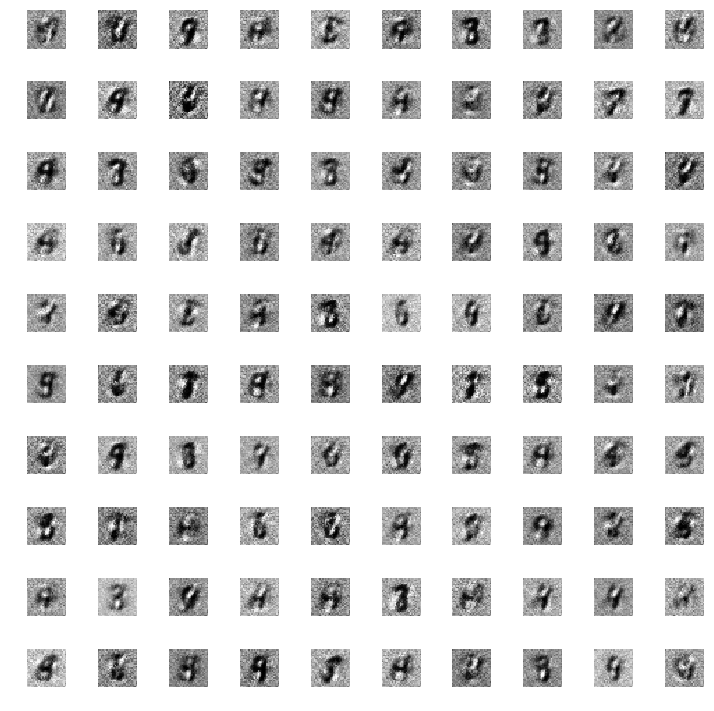

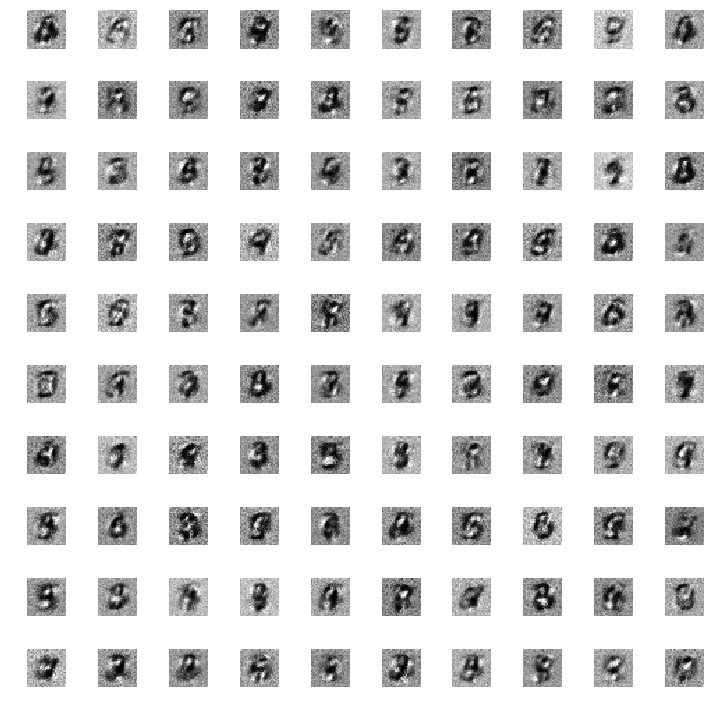

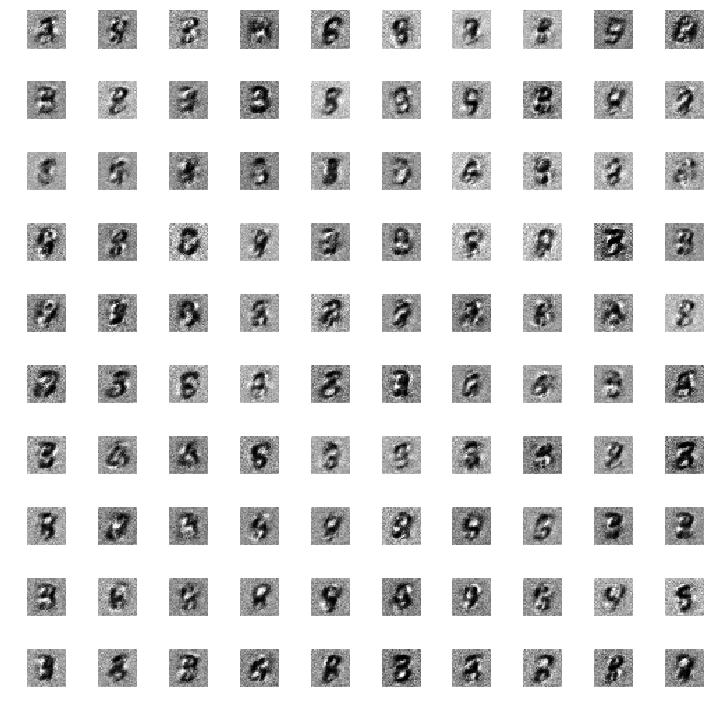

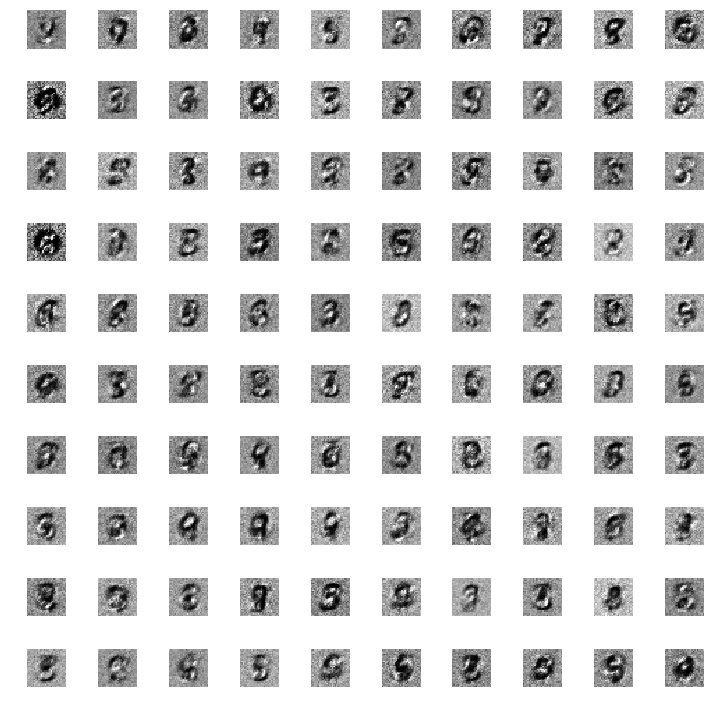

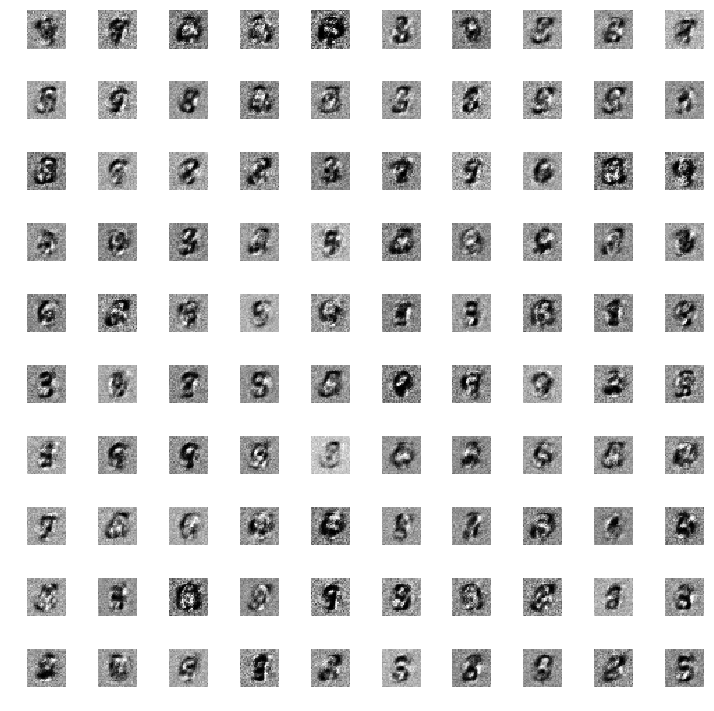

...

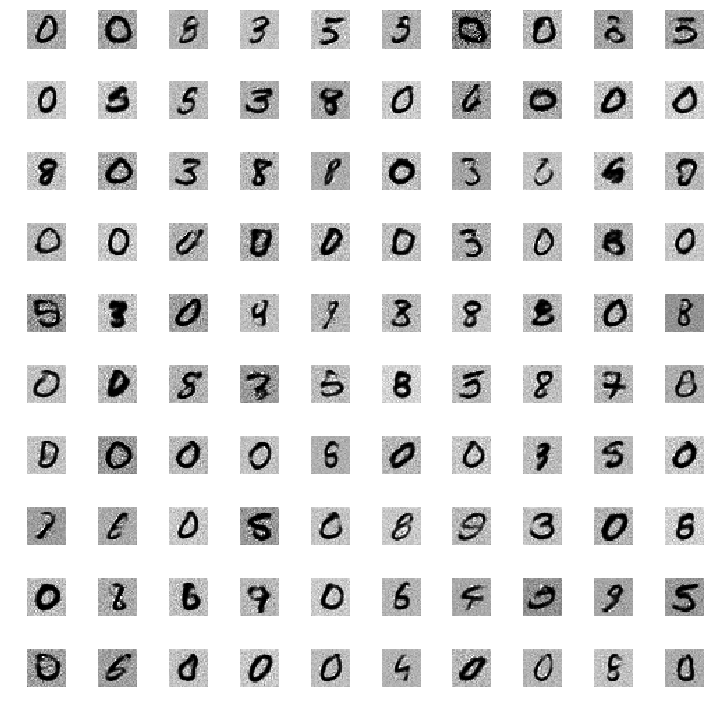

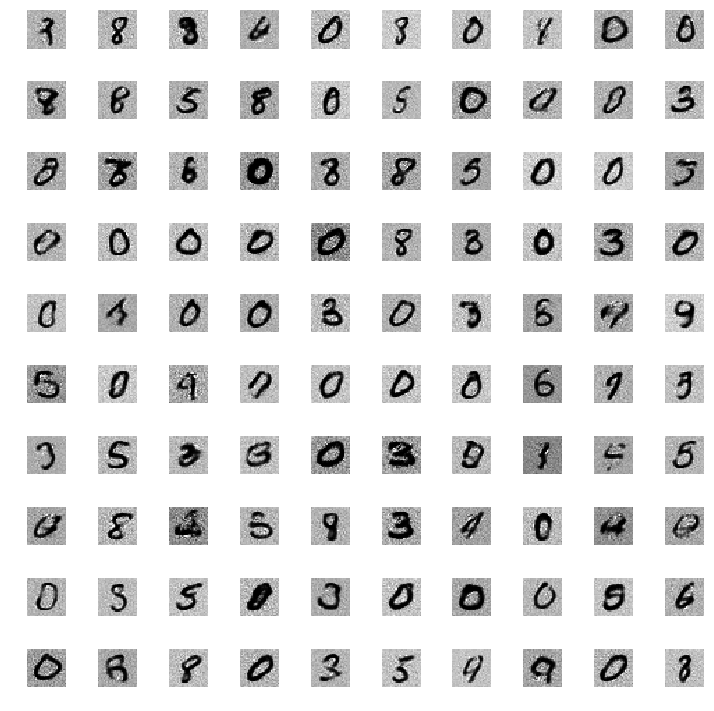

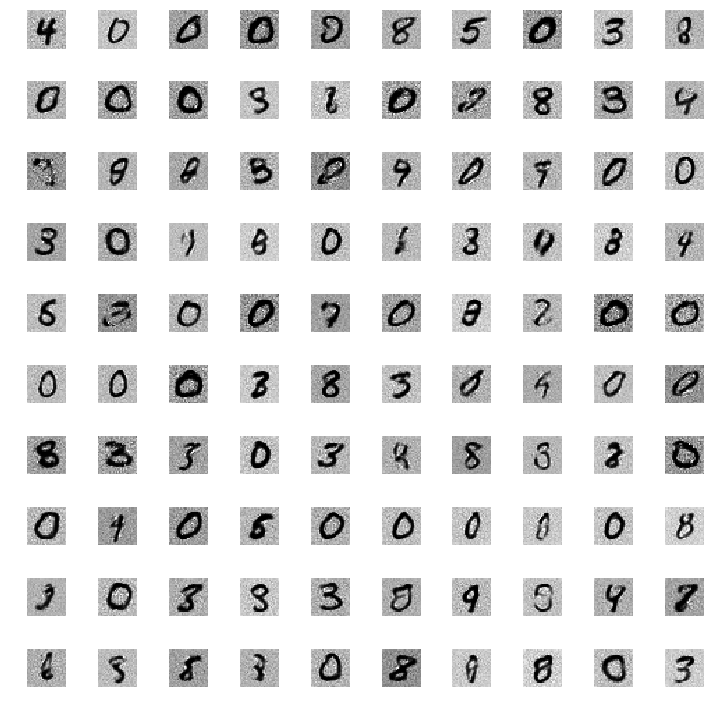

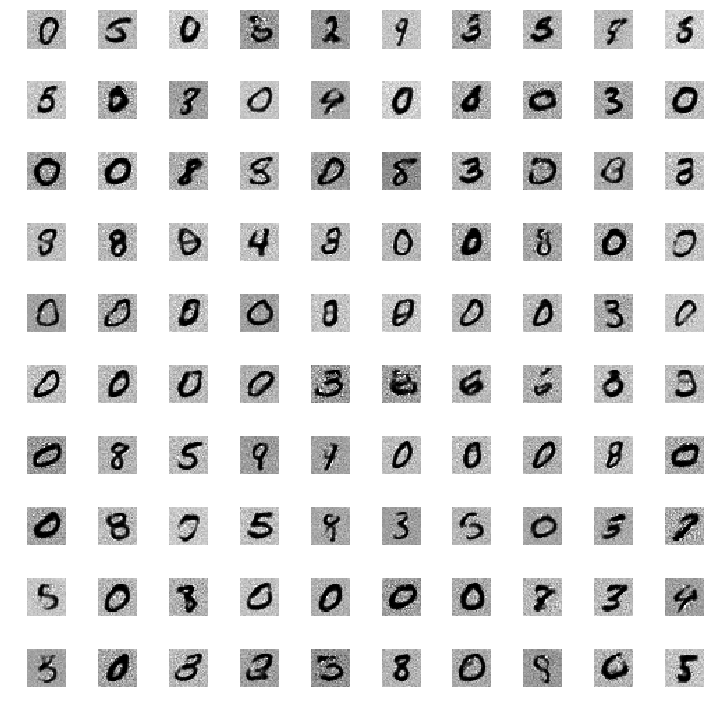

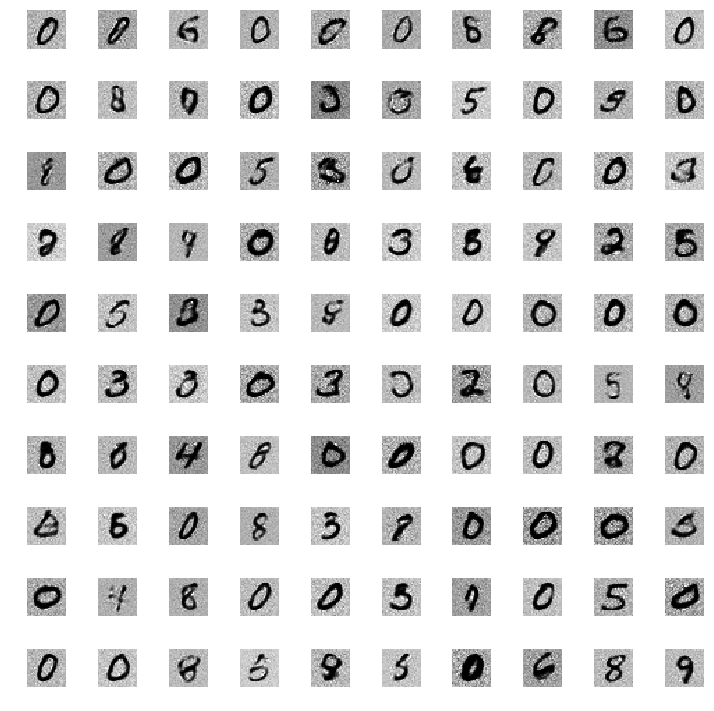

In [14]:
train(100, 128)